In [1]:
import pandas as pd
import numpy as np
from IPython.display import display, Markdown, Latex

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import wrangle_zillow
import modeling
import evaluate
from wrangle import clean_zillow, summarize, split_data_continuous
from viz import get_viz
from viz import boxplots, hists, heatmaps, slicer, haversine

import scipy.stats as stats

from sklearn.metrics import mean_squared_error, explained_variance_score
from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.cluster import KMeans

import warnings
warnings.filterwarnings("ignore")

# Acquire

In [2]:
df = clean_zillow()

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    41067 non-null  int64  
 1   parcel                41067 non-null  int64  
 2   logerror              41067 non-null  float64
 3   bathrooms             41067 non-null  object 
 4   bedrooms              41067 non-null  object 
 5   tot_sqft              41067 non-null  float64
 6   fips                  41067 non-null  object 
 7   hot_tub               41067 non-null  float64
 8   lat                   41067 non-null  float64
 9   lon                   41067 non-null  float64
 10  lot_sqft              41067 non-null  float64
 11  pools                 41067 non-null  int64  
 12  county_landuse        41067 non-null  object 
 13  raw_tract_and_block   41067 non-null  float64
 14  city_id               41067 non-null  object 
 15  zip_code           

# Prepare

In [3]:
df['house_age_bin'] = pd.cut(df.house_age, 
                           bins = [0, 5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140],
                           labels = [0, .066, .133, .20, .266, .333, .40, .466, .533, 
                                     .60, .666, .733, .8, .866, .933])

df['taxrate'] = df.tax_amount/df.tax_value*100

df['acres'] = df.lot_sqft/ 43560

df['acres_bin'] = pd.cut(df.acres, bins = [0, .10, .15, .25, .5, 1, 5, 10, 20, 50, 200], 
                       labels = [0, .1, .2, .3, .4, .5, .6, .7, .8, .9])

df['tot_sqft_bin'] = pd.cut(df.tot_sqft, 
                            bins = [0, 800, 1000, 1250, 1500, 2000, 2500, 3000, 4000, 7000, 12000],
                            labels = [0, .1, .2, .3, .4, .5, .6, .7, .8, .9]
                       )

df['structure_dollar_per_sqft'] = df.building_tax_value / df.tot_sqft

df['structure_dollar_sqft_bin'] = pd.cut(df.structure_dollar_per_sqft, 
                                             bins = [0, 25, 50, 75, 100, 150, 200, 300, 500, 1000, 1500],
                                             labels = [0, .1, .2, .3, .4, .5, .6, .7, .8, .9]
                                            )

df['land_dollar_per_sqft'] = df.land_tax_value / df.lot_sqft

df['land_dollar_sqft_bin'] = pd.cut(df.land_dollar_per_sqft, bins = [0, 1, 5, 20, 50, 100, 250, 500, 1000, 1500, 2000],
                                       labels = [0, .1, .2, .3, .4, .5, .6, .7, .8, .9]
                                      )

df = df.astype({'tot_sqft_bin': 'float64', 'acres_bin': 'float64', 'house_age_bin': 'float64',
                    'structure_dollar_sqft_bin': 'float64', 'land_dollar_sqft_bin': 'float64'})


df.bedrooms = df.bedrooms.map({'_4_':4, '_3_':3, '_2_': 2, '_5_': 5})

df.bathrooms = df.bathrooms.map({'_4_':4, '_3_':3, '_2_': 2, '_5_': 5, '_1_':1})

df['bed_bath_ratio'] = df.bedrooms/ df.bathrooms

df['incity_la'] = df.city_id.apply(lambda x: 1 if x == 12447 else 0)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 36 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id                         41067 non-null  int64  
 1   parcel                     41067 non-null  int64  
 2   logerror                   41067 non-null  float64
 3   bathrooms                  41067 non-null  int64  
 4   bedrooms                   41067 non-null  int64  
 5   tot_sqft                   41067 non-null  float64
 6   fips                       41067 non-null  object 
 7   hot_tub                    41067 non-null  float64
 8   lat                        41067 non-null  float64
 9   lon                        41067 non-null  float64
 10  lot_sqft                   41067 non-null  float64
 11  pools                      41067 non-null  int64  
 12  county_landuse             41067 non-null  object 
 13  raw_tract_and_block        41067 non-null  flo

In [4]:
fips = pd.get_dummies(df.fips)

df = pd.concat([df, fips], axis=1)

In [5]:
df = df.drop(columns= ['bedrooms','tax_amount', 'tax_value','structure_dollar_per_sqft', 'land_dollar_per_sqft', 'lot_sqft','tax_delinquency_flag','land_tax_value','building_tax_value','city_id', 'rsle','pools', 'hot_tub','zip_code', 'county_landuse', 'tract_and_block', 'half_baths', 'id', 'parcel', 'raw_tract_and_block','fips'])

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 18 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   logerror                   41067 non-null  float64
 1   bathrooms                  41067 non-null  int64  
 2   tot_sqft                   41067 non-null  float64
 3   lat                        41067 non-null  float64
 4   lon                        41067 non-null  float64
 5   house_age                  41067 non-null  int64  
 6   house_age_bin              41067 non-null  float64
 7   taxrate                    41067 non-null  float64
 8   acres                      41067 non-null  float64
 9   acres_bin                  41067 non-null  float64
 10  tot_sqft_bin               41067 non-null  float64
 11  structure_dollar_sqft_bin  41067 non-null  float64
 12  land_dollar_sqft_bin       41067 non-null  float64
 13  bed_bath_ratio             41067 non-null  flo

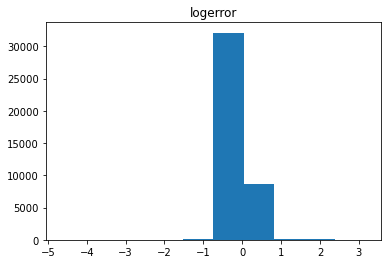

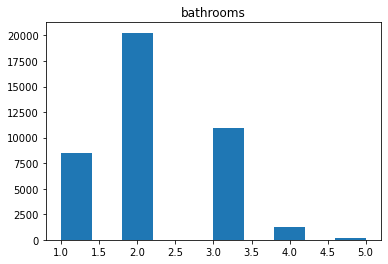

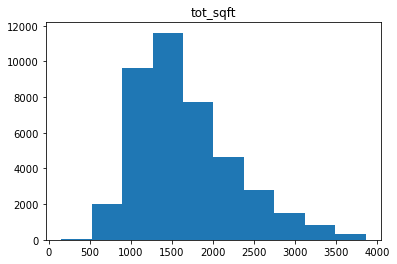

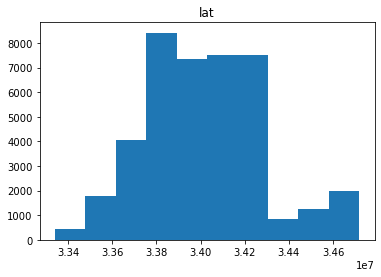

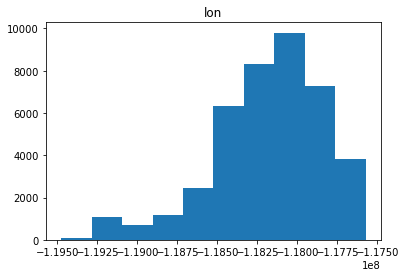

...

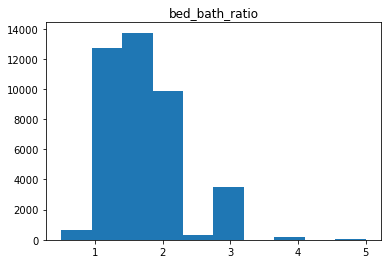

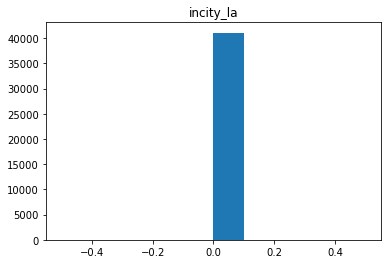

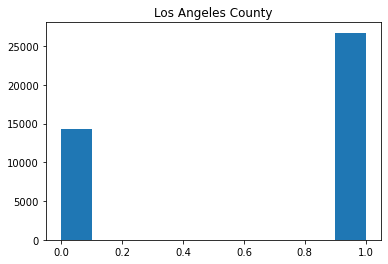

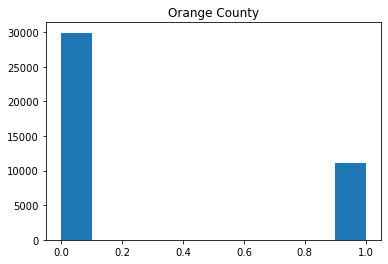

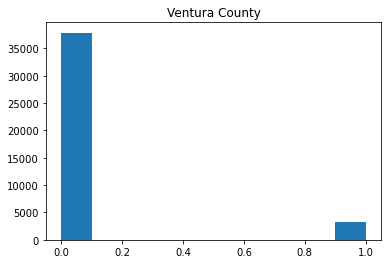

In [7]:
for col in df.columns:
    plt.hist(df[col])
    plt.title(col)
    plt.show()

In [8]:
partitions = wrangle_zillow.split(df, target_var= 'logerror')

In [9]:
train = partitions[0]
train['logerror_bins'] = pd.cut(train.logerror, [-5, -.2, -.05, .05, .2, 4])
# partitions[0] = train

In [10]:
train.logerror_bins.value_counts()

(-0.05, 0.05]    15469
(0.05, 0.2]       3290
(-0.2, -0.05]     2767
(0.2, 4.0]        1010
(-5.0, -0.2]       461
Name: logerror_bins, dtype: int64

In [11]:
validate = partitions[1]
test = partitions[2]

In [12]:
train.shape

(22997, 19)

In [13]:
validate.shape

(9856, 18)

In [14]:
test.shape

(8214, 18)

In [15]:
X_train = partitions[3]
X_validate = partitions[4]
X_test = partitions[5]
y_train = partitions[6]
y_validate = partitions[7]
y_test = partitions[8]

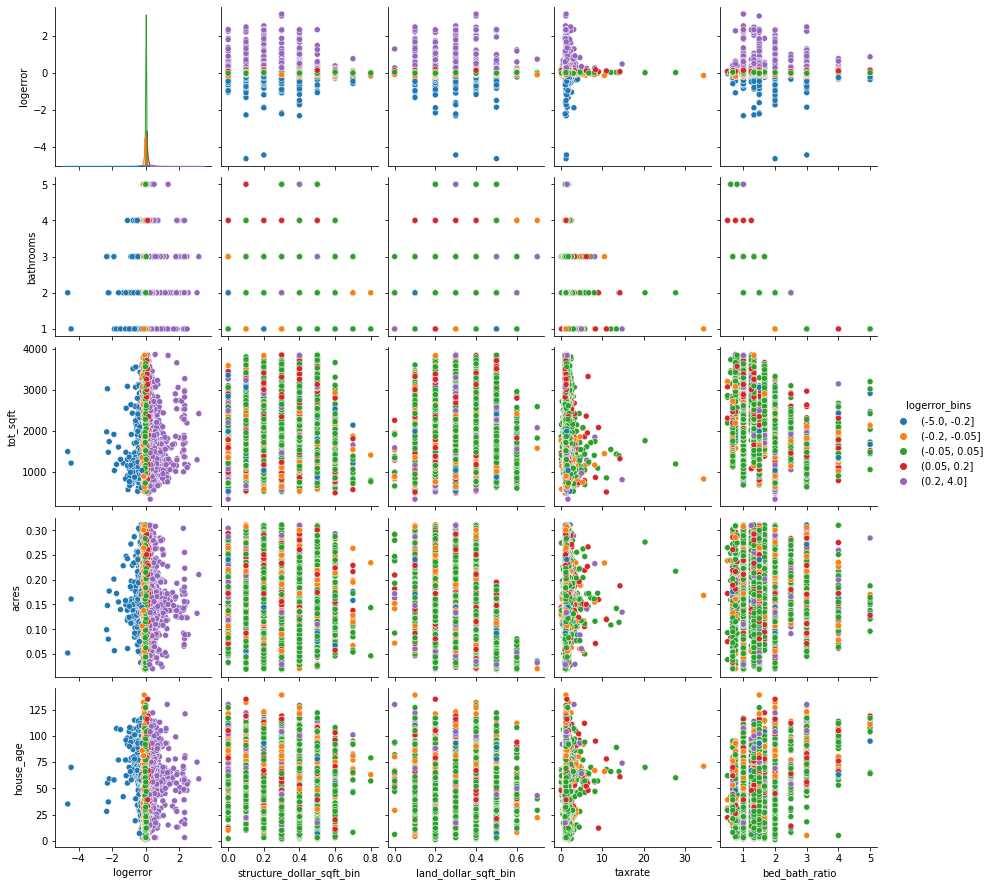

In [16]:
sns.pairplot(data = train, hue = 'logerror_bins', 
             x_vars = ['logerror', 'structure_dollar_sqft_bin', 'land_dollar_sqft_bin', 'taxrate', 
                       'bed_bath_ratio'],
             y_vars = ['logerror', 'bathrooms', 'tot_sqft', 'acres', 'house_age'])

In [17]:
train.columns

Index(['logerror', 'bathrooms', 'tot_sqft', 'lat', 'lon', 'house_age',
       'house_age_bin', 'taxrate', 'acres', 'acres_bin', 'tot_sqft_bin',
       'structure_dollar_sqft_bin', 'land_dollar_sqft_bin', 'bed_bath_ratio',
       'incity_la', 'Los Angeles County', 'Orange County', 'Ventura County',
       'logerror_bins'],
      dtype='object')

In [18]:
# the variables that still need scaling
scaled_vars = ['lat', 'lon', 'bathrooms', 'taxrate']

# create new column names for the scaled variables by adding 'scaled_' to the beginning of each variable name 
scaled_column_names = ['scaled_' + i for i in scaled_vars]

# select the X partitions: [X_train, X_validate, X_test]
X = partitions[3:6]

# fit the minmaxscaler to X_train
X_train = X[0]
scaler = MinMaxScaler(copy=True).fit(X_train[scaled_vars])



def scale_and_concat(df):
    scaled_array = scaler.transform(df[scaled_vars])
    scaled_df = pd.DataFrame(scaled_array, columns=scaled_column_names, index=df.index.values)
    return pd.concat((df, scaled_df), axis=1)

for i in range(len(X)):
    X[i] = scale_and_concat(X[i])



In [19]:
# recall: X[0] is X_train, X[1] is X_validate and X[2] is X_test
X[0].head()


,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,...,land_dollar_sqft_bin,bed_bath_ratio,incity_la,Los Angeles County,Orange County,Ventura County,scaled_lat,scaled_lon,scaled_bathrooms,scaled_taxrate
13298,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,...,0.2,1.333333,0,0,1,0,0.188489,0.912905,0.50,0.027677
29471,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,...,0.2,1.500000,0,0,0,1,0.641659,0.251333,0.25,0.031368
21090,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,...,0.4,1.333333,0,1,0,0,0.467739,0.820539,0.50,0.034279
17252,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,...,0.3,1.500000,0,1,0,0,0.503080,0.606126,0.25,0.035334
38210,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,...,0.4,3.000000,0,1,0,0,0.338640,0.576816,0.00,0.032947


In [20]:
train.head()

,logerror,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,structure_dollar_sqft_bin,land_dollar_sqft_bin,bed_bath_ratio,incity_la,Los Angeles County,Orange County,Ventura County,logerror_bins
13298,-0.000586,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,0.4,0.2,1.333333,0,0,1,0,"(-0.05, 0.05]"
29471,1.024158,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,0.3,0.2,1.500000,0,0,0,1,"(0.2, 4.0]"
21090,0.041108,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,0.4,0.4,1.333333,0,1,0,0,"(-0.05, 0.05]"
17252,-0.046087,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,0.1,0.3,1.500000,0,1,0,0,"(-0.05, 0.05]"
38210,0.103417,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,0.1,0.4,3.000000,0,1,0,0,"(0.05, 0.2]"


# Explore

## How does the acreage affect logerror?

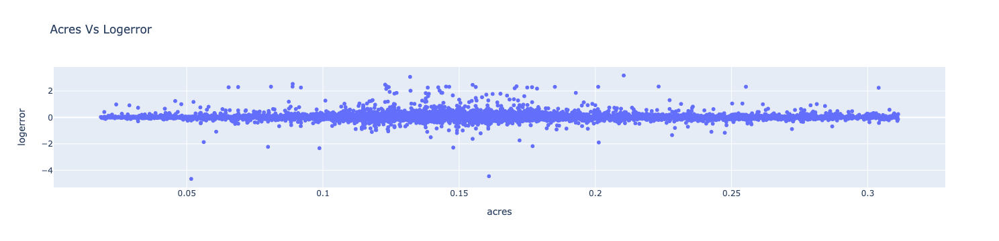

In [21]:
px.scatter(data_frame=train,
                x= train.acres,
                y= 'logerror',
           title = 'Acres Vs Logerror'
               )

### Homes between about .12 and .25 have the greatest amount of error and more positive error than negative error

## Is there a relationship between tax rate and logerror?

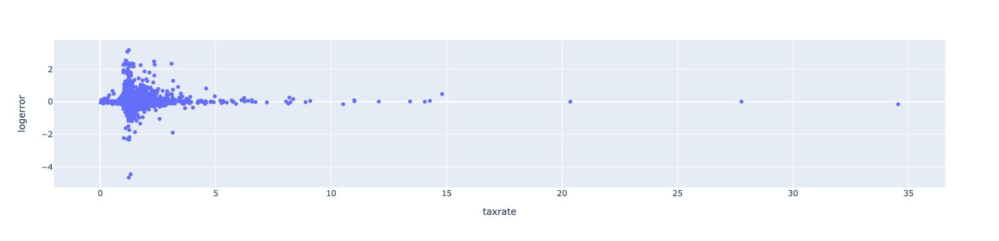

In [22]:
px.scatter(data_frame=train,
                x= train.taxrate,
                y= 'logerror'
               )

## It looks like the higher the Tax Rate, the less the logerror
- We will test this

In [23]:
r, p_value = stats.pearsonr(x= train.taxrate, y= train.logerror)
print(r, p_value)

0.01115005789923605 0.090867295641755


In [24]:
α = .05

if p_value < α:
    print(f'We can REJECT the Null Hₒ: There is no correlation between Tax Rate and Logerror\nWith Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print('We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror')

We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror


## How does the age of properties effect logerror?

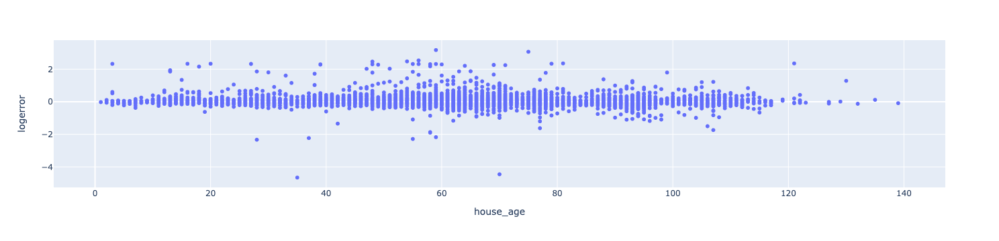

In [25]:
px.scatter(data_frame=train,
                x= train.house_age,
                y= train.logerror,
               )

## Seems like error is greatest amongst homes that fall between about 40 and 80 years of age with it being more on the positive end

## How does structure dollar/sqft and land dollar/sqft affect logerror and are the two features similar?

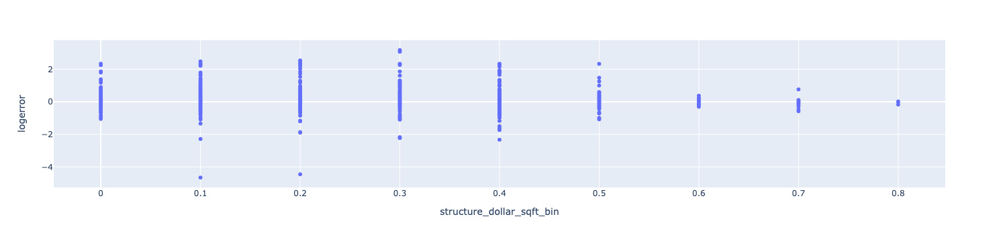

In [26]:
px.scatter(data_frame=train,
                x= train.structure_dollar_sqft_bin,
                y= train.logerror,
               )

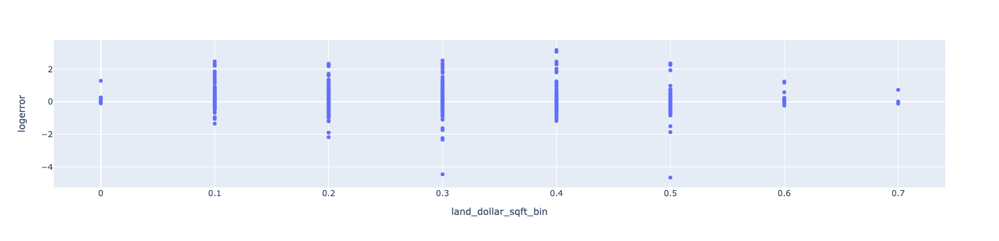

In [27]:
px.scatter(data_frame=train,
                x= train.land_dollar_sqft_bin,
                y= train.logerror,
               )

### The more dollars in land and structure per area the less error there is.  Both land dollar and structure dollar features seem to be similar in how they correlate with logerror....let's test it

In [28]:
# list of variables I will cluster on. 
cluster_vars = ['scaled_lat', 'scaled_lon', 'house_age_bin']
cluster_name = 'area_cluster'
k_range = range(2,20)


In [29]:
def find_k(X_train, cluster_vars, k_range):
    sse = []
    for k in k_range:
        kmeans = KMeans(n_clusters=k)

        # X[0] is our X_train dataframe..the first dataframe in the list of dataframes stored in X. 
        kmeans.fit(X_train[cluster_vars])

        # inertia: Sum of squared distances of samples to their closest cluster center.
        sse.append(kmeans.inertia_) 

    # compute the difference from one k to the next
    delta = [round(sse[i] - sse[i+1],0) for i in range(len(sse)-1)]

    # compute the percent difference from one k to the next
    pct_delta = [round(((sse[i] - sse[i+1])/sse[i])*100, 1) for i in range(len(sse)-1)]

    # create a dataframe with all of our metrics to compare them across values of k: SSE, delta, pct_delta
    k_comparisons_df = pd.DataFrame(dict(k=k_range[0:-1], 
                             sse=sse[0:-1], 
                             delta=delta, 
                             pct_delta=pct_delta))

    # plot k with inertia
    plt.plot(k_comparisons_df.k, k_comparisons_df.sse, 'bx-')
    plt.xlabel('k')
    plt.ylabel('SSE')
    plt.title('The Elbow Method to find the optimal k\nFor which k values do we see large decreases in SSE?')
    plt.show()

    # plot k with pct_delta
    plt.plot(k_comparisons_df.k, k_comparisons_df.pct_delta, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Percent Change')
    plt.title('For which k values are we seeing increased changes (%) in SSE?')
    plt.show()

    # plot k with delta
    plt.plot(k_comparisons_df.k, k_comparisons_df.delta, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Absolute Change in SSE')
    plt.title('For which k values are we seeing increased changes (absolute) in SSE?')
    plt.show()

    return k_comparisons_df


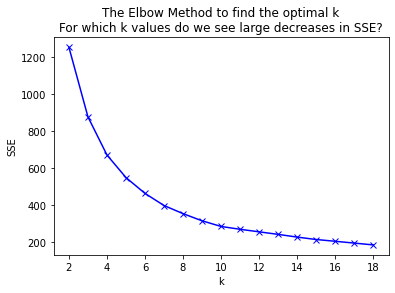

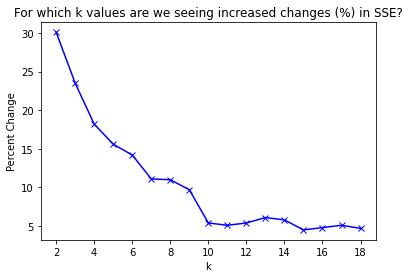

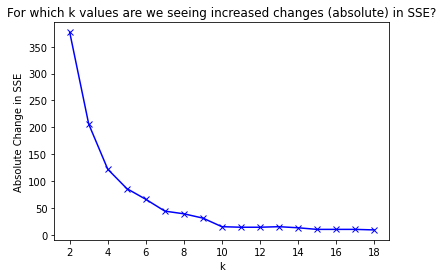

,k,sse,delta,pct_delta
0,2,1253.743268,377.0,30.1
1,3,876.973126,206.0,23.5
2,4,670.496036,122.0,18.2
3,5,548.378592,86.0,15.6
4,6,462.680062,66.0,14.2
5,7,397.133081,44.0,11.1
6,8,353.122227,39.0,11.0
7,9,314.373232,31.0,9.7
8,10,283.842729,15.0,5.4
9,11,268.436232,14.0,5.1


In [30]:
find_k(X[0], cluster_vars, k_range)

In [31]:
k = 5
# as reminders: 
cluster_vars = ['scaled_lat', 'scaled_lon', 'house_age_bin']
cluster_name = 'area_cluster'

In [32]:
def create_clusters(X_train, k, cluster_vars):
    # create kmean object
    kmeans = KMeans(n_clusters=k, random_state = 13)

    # fit to train and assign cluster ids to observations
    kmeans.fit(X_train[cluster_vars])

    return kmeans

In [33]:
kmeans = create_clusters(X[0], k, cluster_vars)

In [34]:
# get the centroids for each distinct cluster...

def get_centroids(kmeans, cluster_vars, cluster_name):
    # get the centroids for each distinct cluster...

    centroid_col_names = ['centroid_' + i for i in cluster_vars]

    centroid_df = pd.DataFrame(kmeans.cluster_centers_, 
                               columns=centroid_col_names).reset_index().rename(columns={'index': cluster_name})

    return centroid_df

In [35]:
centroid_df = get_centroids(kmeans, cluster_vars, cluster_name)

In [36]:
# label cluster for each observation in X_train (X[0] in our X list of dataframes), 
# X_validate (X[1]), & X_test (X[2])

def assign_clusters(kmeans, cluster_vars, cluster_name, centroid_df):
    for i in range(len(X)):
        clusters = pd.DataFrame(kmeans.predict(X[i][cluster_vars]), 
                            columns=[cluster_name], index=X[i].index)

        clusters_centroids = clusters.merge(centroid_df, on=cluster_name, copy=False).set_index(clusters.index.values)

        X[i] = pd.concat([X[i], clusters_centroids], axis=1)
    return X


In [37]:
X = assign_clusters(kmeans, cluster_vars, cluster_name, centroid_df)

In [38]:
pd.DataFrame(X[0].groupby(['area_cluster', 'centroid_scaled_lat', 'centroid_scaled_lon', 
                           'centroid_house_age_bin'])['area_cluster'].count())

,,,,area_cluster
area_cluster,centroid_scaled_lat,centroid_scaled_lon,centroid_house_age_bin,
0,0.918069,0.686900,0.229156,1743
1,0.411161,0.753882,0.426964,8715
2,0.553974,0.602872,0.547988,5852
3,0.664522,0.348307,0.321102,2984
4,0.239662,0.892914,0.256627,3703


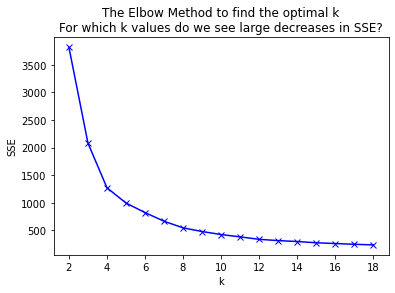

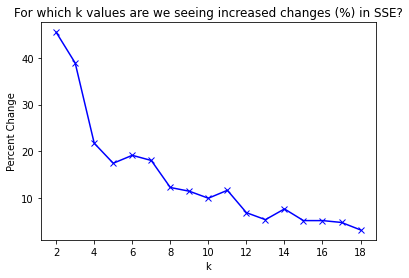

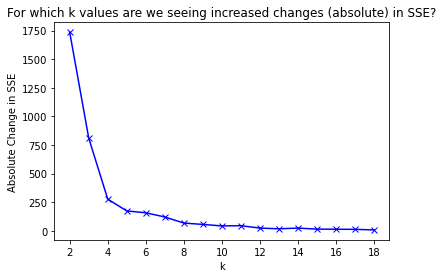

,k,sse,delta,pct_delta
0,2,3818.195793,1736.0,45.5
1,3,2082.325960,810.0,38.9
2,4,1272.188090,276.0,21.7
3,5,996.175031,173.0,17.4
4,6,823.124796,157.0,19.1
5,7,666.283318,120.0,18.0
6,8,546.598587,67.0,12.2
7,9,480.069301,55.0,11.4
8,10,425.324485,42.0,9.9
9,11,383.093778,44.0,11.6


In [39]:
cluster_vars = ['scaled_bathrooms', 'tot_sqft_bin', 'acres_bin', 'bed_bath_ratio']
cluster_name = 'size_cluster'
k_range = range(2,20)

find_k(X[0], cluster_vars, k_range)

In [40]:
k=6
cluster_name = 'size_cluster'
cluster_vars = ['scaled_bathrooms', 'tot_sqft_bin', 'acres_bin', 'bed_bath_ratio']

# fit kmeans 
kmeans = create_clusters(X[0], k, cluster_vars)

# get centroid values per variable per cluster
centroid_df = get_centroids(kmeans, cluster_vars, cluster_name)

# get cluster assignments and append those with centroids for each X partition (train, validate, test)
X = assign_clusters(kmeans, cluster_vars, cluster_name, centroid_df)

In [41]:
pd.DataFrame(X[0].groupby(['size_cluster', 'centroid_scaled_bathrooms', 'centroid_tot_sqft_bin',
                              'centroid_acres_bin', 'centroid_bed_bath_ratio'])['area_cluster'].count())

,,,,,area_cluster
size_cluster,centroid_scaled_bathrooms,centroid_tot_sqft_bin,centroid_acres_bin,centroid_bed_bath_ratio,
0,5.137232e-01,0.530947,0.160992,1.383475,3771
1,2.446245e-01,0.377535,0.164602,2.030969,3116
2,-7.216450e-16,0.221793,0.132666,3.071531,2097
3,2.532042e-01,0.322169,0.151676,1.501901,7100
4,-7.771561e-16,0.134880,0.111949,2.000000,2586
5,4.611740e-01,0.425399,0.124520,0.975738,4327


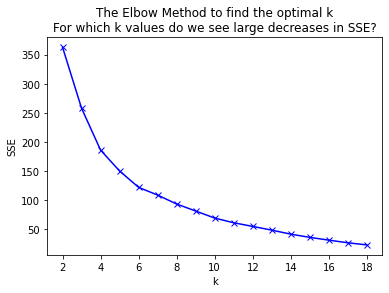

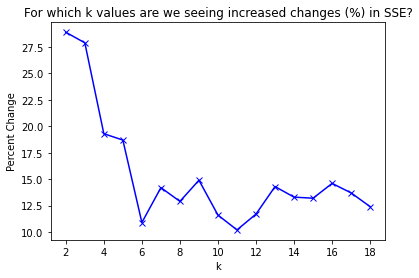

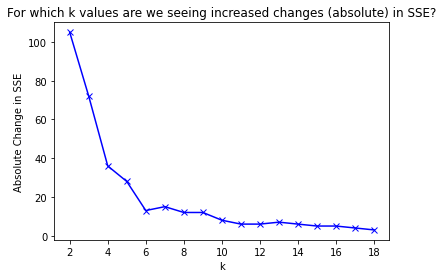

,k,sse,delta,pct_delta
0,2,362.553605,105.0,28.9
1,3,257.733601,72.0,27.9
2,4,185.856885,36.0,19.3
3,5,149.966758,28.0,18.7
4,6,121.871531,13.0,10.9
5,7,108.634020,15.0,14.2
6,8,93.256990,12.0,12.9
7,9,81.255229,12.0,14.9
8,10,69.112363,8.0,11.6
9,11,61.063019,6.0,10.2


In [42]:
cluster_vars = ['scaled_taxrate', 'structure_dollar_sqft_bin', 'land_dollar_sqft_bin']
cluster_name = 'price_cluster'
k_range = range(2,20)

find_k(X[0], cluster_vars, k_range)

In [43]:
k=6
cluster_name = 'price_cluster'
cluster_vars = ['scaled_taxrate', 'structure_dollar_sqft_bin', 'land_dollar_sqft_bin']

# fit kmeans 
kmeans = create_clusters(X[0], k, cluster_vars)

# get centroid values per variable per cluster
centroid_df = get_centroids(kmeans, cluster_vars, cluster_name)

# get cluster assignments and append those with centroids for each X partition (train, validate, test)
X = assign_clusters(kmeans, cluster_vars, cluster_name, centroid_df)

In [44]:
pd.DataFrame(X[0].groupby(['price_cluster', 'centroid_scaled_taxrate', 'centroid_structure_dollar_sqft_bin',
                           'centroid_land_dollar_sqft_bin'])['area_cluster'].count())

,,,,area_cluster
price_cluster,centroid_scaled_taxrate,centroid_structure_dollar_sqft_bin,centroid_land_dollar_sqft_bin,
0,0.034165,0.441956,0.414495,3201
1,0.047735,0.073752,0.136981,4286
2,0.036003,0.161509,0.311384,3180
3,0.043470,0.212036,0.162764,2127
4,0.036901,0.350398,0.262450,6530
5,0.033526,0.249251,0.424884,3673


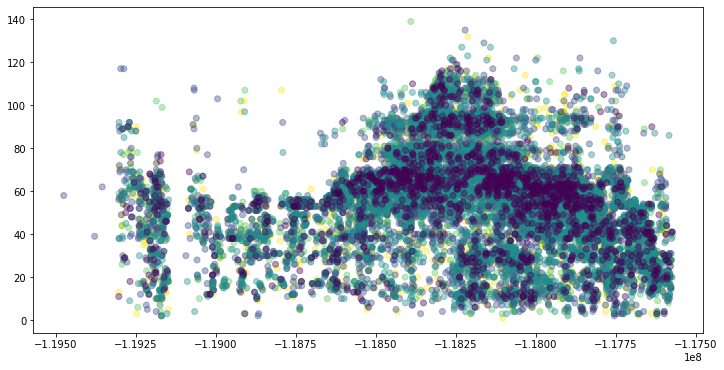

In [45]:
plt.figure(figsize=(12,6))
# plt.scatter(y=X_train.latitude, x=X_train.longitude, c=X_train.area_cluster, alpha=.4)
plt.scatter(y=X[0].house_age, x=X[0].lon, c=X[0].area_cluster, alpha=.4)


In [46]:
X[0].columns

Index(['bathrooms', 'tot_sqft', 'lat', 'lon', 'house_age', 'house_age_bin',
       'taxrate', 'acres', 'acres_bin', 'tot_sqft_bin',
       'structure_dollar_sqft_bin', 'land_dollar_sqft_bin', 'bed_bath_ratio',
       'incity_la', 'Los Angeles County', 'Orange County', 'Ventura County',
       'scaled_lat', 'scaled_lon', 'scaled_bathrooms', 'scaled_taxrate',
       'area_cluster', 'centroid_scaled_lat', 'centroid_scaled_lon',
       'centroid_house_age_bin', 'size_cluster', 'centroid_scaled_bathrooms',
       'centroid_tot_sqft_bin', 'centroid_acres_bin',
       'centroid_bed_bath_ratio', 'price_cluster', 'centroid_scaled_taxrate',
       'centroid_structure_dollar_sqft_bin', 'centroid_land_dollar_sqft_bin'],
      dtype='object')

Text(0.5, 1.0, 'Do clusters reveal differences in age and error?')

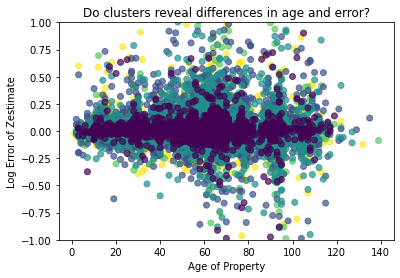

In [47]:
y_train = partitions[-3]

plt.scatter(y=y_train.logerror, x=X[0].house_age, c=X[0].area_cluster, alpha=.7)
plt.ylim(-1,1)
plt.xlabel('Age of Property')
plt.ylabel('Log Error of Zestimate')
plt.title("Do clusters reveal differences in age and error?")


In [48]:
X[0].shape

(22997, 34)

In [49]:
X[1].shape

(9856, 34)

In [50]:
X[2].shape

(8214, 34)

In [51]:
X[0].head()

,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,...,centroid_house_age_bin,size_cluster,centroid_scaled_bathrooms,centroid_tot_sqft_bin,centroid_acres_bin,centroid_bed_bath_ratio,price_cluster,centroid_scaled_taxrate,centroid_structure_dollar_sqft_bin,centroid_land_dollar_sqft_bin
13298,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
29471,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
21090,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
17252,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
38210,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245


In [52]:
X_train.head()

,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,structure_dollar_sqft_bin,land_dollar_sqft_bin,bed_bath_ratio,incity_la,Los Angeles County,Orange County,Ventura County
13298,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,0.4,0.2,1.333333,0,0,1,0
29471,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,0.3,0.2,1.500000,0,0,0,1
21090,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,0.4,0.4,1.333333,0,1,0,0
17252,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,0.1,0.3,1.500000,0,1,0,0
38210,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,0.1,0.4,3.000000,0,1,0,0


(-1.0, 1.0)

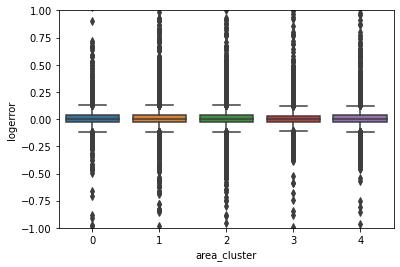

In [53]:
sns.boxplot(y=y_train.logerror, x=X[0].area_cluster)
plt.ylim(-1, 1)

In [72]:
X[0]

,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,...,centroid_house_age_bin,size_cluster,centroid_scaled_bathrooms,centroid_tot_sqft_bin,centroid_acres_bin,centroid_bed_bath_ratio,price_cluster,centroid_scaled_taxrate,centroid_structure_dollar_sqft_bin,centroid_land_dollar_sqft_bin
13298,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.262450
29471,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.262450
21090,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.262450
17252,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.262450
38210,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.262450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21401,4,3126.0,34078115.0,-118557814.0,39,0.266,1.224511,0.210836,0.2,0.7,...,0.229156,1,0.244625,0.377535,0.164602,2.030969,1,0.047735,0.073752,0.136981
5949,2,1857.0,34172930.0,-118178761.0,60,0.400,1.296046,0.283150,0.3,0.4,...,0.229156,1,0.244625,0.377535,0.164602,2.030969,1,0.047735,0.073752,0.136981
25049,1,888.0,34256546.0,-118292578.0,81,0.600,1.248289,0.137534,0.1,0.1,...,0.229156,1,0.244625,0.377535,0.164602,2.030969,1,0.047735,0.073752,0.136981
30529,2,1456.0,33930353.0,-118263659.0,104,0.733,1.317830,0.133563,0.1,0.3,...,0.229156,1,0.244625,0.377535,0.164602,2.030969,1,0.047735,0.073752,0.136981


In [83]:
X[0].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22997 entries, 13298 to 10057
Data columns (total 34 columns):
 #   Column                              Non-Null Count  Dtype   
---  ------                              --------------  -----   
 0   bathrooms                           22997 non-null  int64   
 1   tot_sqft                            22997 non-null  float64 
 2   lat                                 22997 non-null  float64 
 3   lon                                 22997 non-null  float64 
 4   house_age                           22997 non-null  int64   
 5   house_age_bin                       22997 non-null  float64 
 6   taxrate                             22997 non-null  float64 
 7   acres                               22997 non-null  float64 
 8   acres_bin                           22997 non-null  float64 
 9   tot_sqft_bin                        22997 non-null  float64 
 10  structure_dollar_sqft_bin           22997 non-null  float64 
 11  land_dollar_sqft_bin    

In [85]:
X[0].price_cluster = X[0].price_cluster.astype('category')

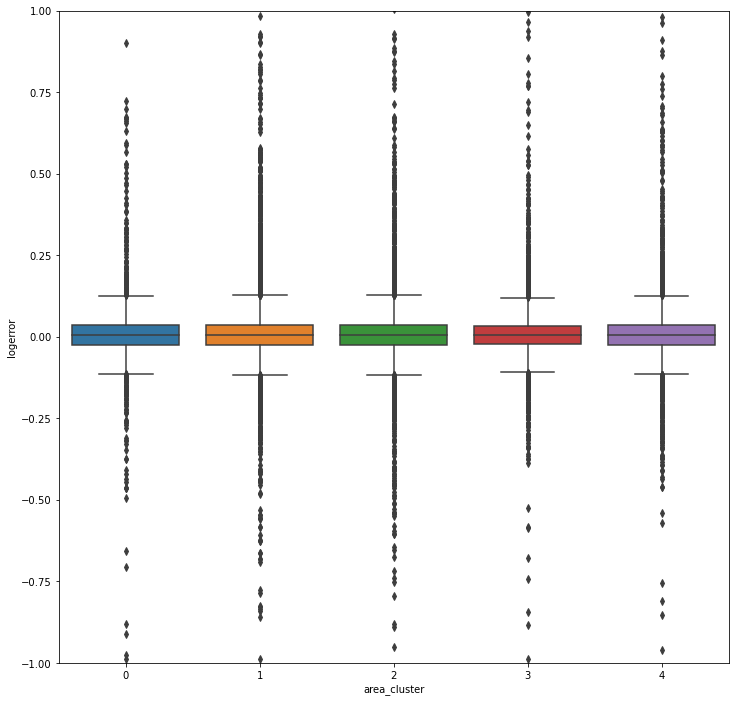

In [69]:
plt.figure(figsize=(12,12))

sns.boxplot(y=y_train.logerror, 
            x=X[0].area_cluster,

           )
plt.ylim(-1, 1)

plt.show()

In [73]:
y_train

,logerror,baseline,OLS,Lasso,Poly
13298,-0.000586,0.016479,0.028940,0.016479,0.029356
29471,1.024158,0.016479,0.019556,0.016479,0.024711
21090,0.041108,0.016479,0.013511,0.016479,0.021169
17252,-0.046087,0.016479,0.015144,0.016479,0.014713
38210,0.103417,0.016479,0.024431,0.016479,0.018898
...,...,...,...,...,...
21401,0.126033,0.016479,0.008382,0.016479,0.006339
5949,-0.029369,0.016479,0.022298,0.016479,0.021104
25049,-0.112953,0.016479,0.004979,0.016479,0.004376
30529,0.270348,0.016479,0.006109,0.016479,-0.001160


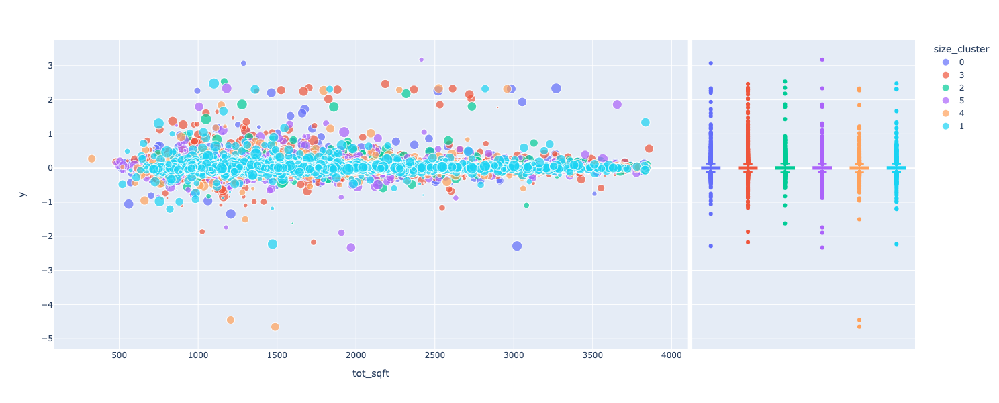

In [88]:
px.scatter(data_frame=X[0],
           x= 'tot_sqft',
           y= y_train.logerror,
           # log_y= True,
           color= 'size_cluster',
          marginal_y='box',
          size=y_train.OLS.abs(),
          height= 600,
          width= 1200)

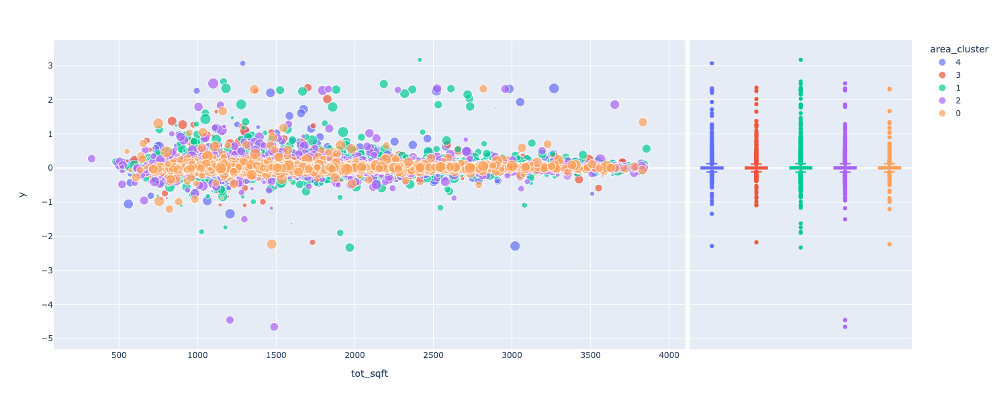

In [89]:
px.scatter(data_frame=X[0],
           x= 'tot_sqft',
           y= y_train.logerror,
           # log_y= True,
           color= 'area_cluster',
          marginal_y='box',
          size=y_train.OLS.abs(),
          height= 600,
          width= 1200)

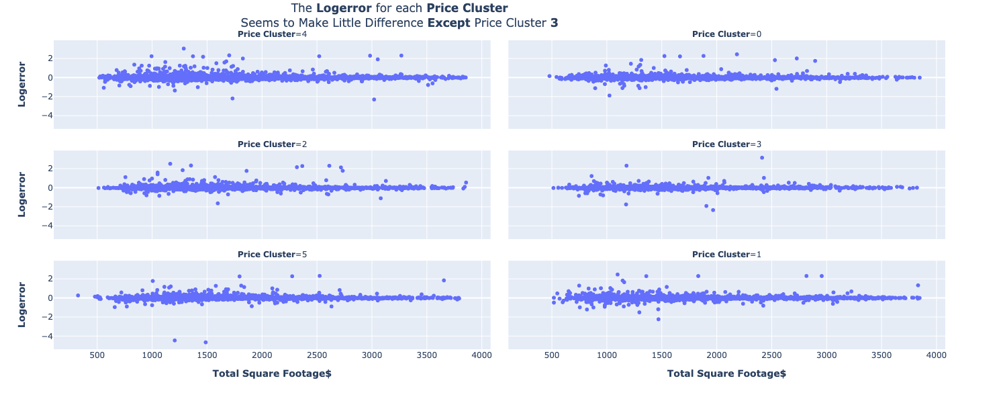

In [104]:
fig_price_cluster = px.scatter(data_frame=X[0],
           x= 'tot_sqft',
           y= y_train.logerror,
           # log_y= True,
           facet_col= 'price_cluster',
                facet_col_wrap=2,
                               # color_discrete_sequence=[0,1,2,3,4,5],
          marginal_y='box',
          # size=y_train.OLS.abs(),
            labels= {'tot_sqft': '<b>Total Square Footage$</b>'
                    ,'y': '<b>Logerror</b>', 'price_cluster':'<b>Price Cluster</b>'},
          height= 600,
          width= 1200)
fig_price_cluster.update_layout(title= {'text': 'The <b>Logerror</b> for each <b>Price Cluster</b><br>\
Seems to Make Little Difference <b>Except</b> Price Cluster <b>3</b>',
                 'x': .4,
                 'y': .97,
                 'xanchor': 'center',
                 'yanchor': 'top'})

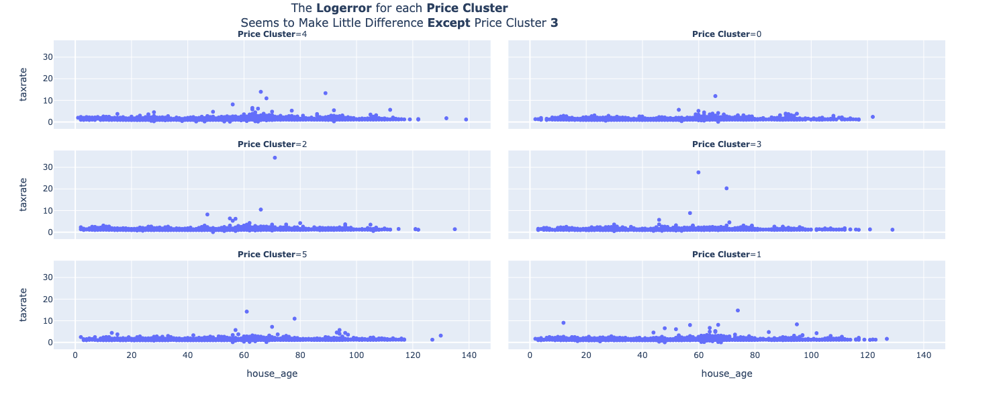

In [108]:
fig_price_cluster = px.scatter(data_frame=X[0],
           x= 'house_age',
           # y= y_train.logerror,
            y= 'taxrate',
           # log_y= True,
           facet_col= 'price_cluster',
                facet_col_wrap=2,
                               # color_discrete_sequence=[0,1,2,3,4,5],
          marginal_y='box',
          # size=y_train.OLS.abs(),
            labels= {'tot_sqft': '<b>Total Square Footage$</b>'
                    ,'y': '<b>Logerror</b>', 'price_cluster':'<b>Price Cluster</b>'},
          height= 600,
          width= 1200)
fig_price_cluster.update_layout(title= {'text': 'The <b>Logerror</b> for each <b>Price Cluster</b><br>\
Seems to Make Little Difference <b>Except</b> Price Cluster <b>3</b>',
                 'x': .4,
                 'y': .97,
                 'xanchor': 'center',
                 'yanchor': 'top'})

In [54]:
# update datatypes of binned values to be float
X[0] = X[0].astype({'size_cluster': 'category', 'area_cluster': 'category'})


In [55]:
X[0].head()

,bathrooms,tot_sqft,lat,lon,house_age,house_age_bin,taxrate,acres,acres_bin,tot_sqft_bin,...,centroid_house_age_bin,size_cluster,centroid_scaled_bathrooms,centroid_tot_sqft_bin,centroid_acres_bin,centroid_bed_bath_ratio,price_cluster,centroid_scaled_taxrate,centroid_structure_dollar_sqft_bin,centroid_land_dollar_sqft_bin
13298,3,2245.0,33600496.0,-117738073.0,23,0.200,0.978716,0.123967,0.1,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
29471,2,1503.0,34224740.0,-118996997.0,38,0.266,1.106162,0.126079,0.1,0.4,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
21090,3,3385.0,33985164.0,-117913839.0,31,0.266,1.206692,0.170087,0.2,0.7,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
17252,2,2223.0,34033846.0,-118321851.0,96,0.666,1.243105,0.195064,0.2,0.5,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245
38210,1,1221.0,33807329.0,-118377626.0,69,0.466,1.160689,0.140840,0.1,0.2,...,0.256627,0,0.513723,0.530947,0.160992,1.383475,4,0.036901,0.350398,0.26245


In [56]:
X[0].info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 22997 entries, 13298 to 10057
Data columns (total 34 columns):
 #   Column                              Non-Null Count  Dtype   
---  ------                              --------------  -----   
 0   bathrooms                           22997 non-null  int64   
 1   tot_sqft                            22997 non-null  float64 
 2   lat                                 22997 non-null  float64 
 3   lon                                 22997 non-null  float64 
 4   house_age                           22997 non-null  int64   
 5   house_age_bin                       22997 non-null  float64 
 6   taxrate                             22997 non-null  float64 
 7   acres                               22997 non-null  float64 
 8   acres_bin                           22997 non-null  float64 
 9   tot_sqft_bin                        22997 non-null  float64 
 10  structure_dollar_sqft_bin           22997 non-null  float64 
 11  land_dollar_sqft_bin    

In [57]:
feat_train = X[0].drop(columns=['centroid_scaled_lat','centroid_scaled_lon','centroid_house_age_bin','centroid_scaled_bathrooms','centroid_tot_sqft_bin',
                              'centroid_acres_bin', 'centroid_bed_bath_ratio', 'centroid_scaled_taxrate', 'centroid_structure_dollar_sqft_bin',
                              'centroid_land_dollar_sqft_bin', 'Los Angeles County', 'Orange County', 'Ventura County', 'bathrooms', 'taxrate', 'lat', 'lon'])
feat_val = X[1].drop(columns=['centroid_scaled_lat','centroid_scaled_lon','centroid_house_age_bin','centroid_scaled_bathrooms','centroid_tot_sqft_bin',
                              'centroid_acres_bin', 'centroid_bed_bath_ratio', 'centroid_scaled_taxrate', 'centroid_structure_dollar_sqft_bin',
                              'centroid_land_dollar_sqft_bin', 'Los Angeles County', 'Orange County', 'Ventura County', 'bathrooms', 'taxrate', 'lat', 'lon'])                             

In [58]:
evaluate.rfe(feat_train, y_train, 4)

,rfe_ranking
tot_sqft,13
house_age,12
house_age_bin,1
acres,4
acres_bin,5
tot_sqft_bin,3
structure_dollar_sqft_bin,1
land_dollar_sqft_bin,1
bed_bath_ratio,7
incity_la,14


In [59]:
feat_train.columns

Index(['tot_sqft', 'house_age', 'house_age_bin', 'acres', 'acres_bin',
       'tot_sqft_bin', 'structure_dollar_sqft_bin', 'land_dollar_sqft_bin',
       'bed_bath_ratio', 'incity_la', 'scaled_lat', 'scaled_lon',
       'scaled_bathrooms', 'scaled_taxrate', 'area_cluster', 'size_cluster',
       'price_cluster'],
      dtype='object')

In [60]:
# Eliminate columns that weren't selected to be used in modeling
X_train_alt = feat_train.drop(columns=['tot_sqft', 'house_age', 'acres', 'acres_bin',
       'tot_sqft_bin', 'bed_bath_ratio', 'incity_la', 'scaled_lon',
       'scaled_bathrooms'])
X_validate_alt = feat_val.drop(columns=['tot_sqft', 'house_age', 'acres', 'acres_bin',
       'tot_sqft_bin', 'bed_bath_ratio', 'incity_la', 'scaled_lon',
       'scaled_bathrooms'])

# Create a dataframe for target variable
y_train = pd.DataFrame(y_train)
y_validate = pd.DataFrame(y_validate)

# Establish baseline predictions
baseline = y_train['logerror'].mean()
y_train['baseline'] = baseline
y_validate['baseline'] = baseline

# Calculate RMSE for train and validate dataset
rmse_train = mean_squared_error(y_train.logerror, y_train.baseline) ** .5
rmse_validate = mean_squared_error(y_validate.logerror, y_validate.baseline) ** .5

print('RMSE using Mean\nTrain/In-Sample: ', round(rmse_train,2),
      '\nValidate/Out-of-Sample: ', round(rmse_validate, 2))

# Create a dataframe that tracks the metrics that we will use to compare each model
metric_df = pd.DataFrame(
    data=[{
        'model': 'mean_baseline',
        'rmse': rmse_validate,
        'r^2': explained_variance_score(y_validate.logerror, y_validate.baseline)
    }])

RMSE using Mean
Train/In-Sample:  0.17 
Validate/Out-of-Sample:  0.16


In [61]:
# creating an Ordinary Least Squares model
metric_df = evaluate.model_metrics(LinearRegression(), X_train_alt, y_train, X_validate_alt, y_validate, metric_df)

Name for model? OLS


In [62]:
# creating a Lasso + Lars model
metric_df = evaluate.model_metrics(LassoLars(alpha=1), X_train_alt, y_train, X_validate_alt, y_validate, metric_df)

Name for model? Lasso


In [1]:
# creating a Generalized Linear Model
# metric_df = evaluate.model_metrics(TweedieRegressor(power = , alpha = 1), X_train_alt, y_train, X_validate_alt, y_validate, metric_df)

In [63]:
# making the method
pf = PolynomialFeatures(degree = 2)

# fitting the method and transforming the features into polynomial features
X_train_d2 = pf.fit_transform(X_train_alt)

X_validate_d2 = pf.transform(X_validate_alt)

# making the model
lm2 = LinearRegression(normalize=True)

# fitting the model to the transformed features
lm2.fit(X_train_d2, y_train.logerror)

# making predictions
in_sample_pred = lm2.predict(X_train_d2)
out_sample_pred = lm2.predict(X_validate_d2)
model_name = input('Name for model?')
y_train[model_name] = in_sample_pred
y_validate[model_name] = out_sample_pred

# evaluating error
rmse_val = mean_squared_error(y_validate['logerror'], out_sample_pred, squared=False)
r_squared_val = explained_variance_score(y_validate['logerror'], out_sample_pred)

# appending metrics to metrics table
metric_df = metric_df.append({
        'model': model_name,
        'rmse': rmse_val,
        'r^2': r_squared_val
    }, ignore_index=True)

Name for model? Poly


In [64]:
metric_df

,model,rmse,r^2
0,mean_baseline,0.157262,0.000000e+00
1,OLS,0.157170,1.180814e-03
2,Lasso,0.157262,-2.220446e-16
3,Poly,0.157943,-7.849568e-03


In [65]:
X_test_alt = X_test.drop(columns=[])
y_test = pd.DataFrame(y_test)
y_test['baseline'] = baseline
rmse_test = mean_squared_error(y_test.logerror, y_test.baseline) ** .5

test_metric_df = pd.DataFrame(
    data=[{
        'model': 'mean_baseline',
        'rmse': rmse_test,
        'r^2': explained_variance_score(y_test.logerror, y_test.baseline)
    }])

test_metric_df

,model,rmse,r^2
0,mean_baseline,0.158204,0.0


In [66]:
model = LinearRegression()
model.fit(X_train, y_train['logerror'])
in_sample_pred = model.predict(X_test)
model_name = input('Name for model?')
y_test[model_name] = in_sample_pred

 
rmse_val = mean_squared_error(y_test['logerror'], in_sample_pred, squared=False)
r_squared_val = explained_variance_score(y_test['logerror'], in_sample_pred)
test_metric_df = test_metric_df.append({
    'model': model_name,
    'rmse': rmse_val,
    'r^2': r_squared_val
    }, ignore_index=True)

Name for model? OLS2


In [67]:
test_metric_df

,model,rmse,r^2
0,mean_baseline,0.158204,0.000000
1,OLS2,0.158013,0.002409


# Conclusions and Recommendations

> -  

> - 

> - 